<a href="https://colab.research.google.com/github/sofiabenati/medical-image-segmentation/blob/main/Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
import os

drive.mount('/content/drive')
os.chdir('/content/drive/MyDrive/Colab Notebooks/archive') #cambia workspace
os.listdir()

Mounted at /content/drive


['Supplementary Table 1 for patient info.xlsx',
 'Supplementary Table 2 for  sequence parameters.xlsx',
 'Patient-33',
 'Patient-51',
 'Patient-34',
 'Patient-56',
 'Patient-60',
 'Patient-58',
 'Patient-35',
 'Patient-32',
 'Patient-59',
 'Patient-57',
 'Patient-50',
 'Patient-7',
 'Patient-9',
 'Patient-1',
 'Patient-8',
 'Patient-6',
 'Patient-43',
 'Patient-44',
 'Patient-10',
 'Patient-17',
 'Patient-28',
 'Patient-21',
 'Patient-26',
 'Patient-19',
 'Patient-18',
 'Patient-42',
 'Patient-27',
 'Patient-45',
 'Patient-20',
 'Patient-16',
 'Patient-11',
 'Patient-29',
 'Patient-55',
 'Patient-52',
 'Patient-37',
 'Patient-30',
 'Patient-39',
 'Patient-53',
 'Patient-38',
 'Patient-54',
 'Patient-31',
 'Patient-36',
 'Patient-3',
 'Patient-4',
 'Patient-5',
 'Patient-2',
 'Patient-14',
 'Patient-13',
 'Patient-25',
 'Patient-22',
 'Patient-49',
 'Patient-47',
 'Patient-40',
 'Patient-23',
 'Patient-24',
 'Patient-12',
 'Patient-15',
 'Patient-41',
 'Patient-46',
 'Patient-48']

In [ ]:
!pip install nilearn nibabel scikit-image seaborn opencv-python-headless

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.7/12.7 MB 121.6 MB/s eta 0:00:00


In [ ]:
import os
import cv2
import glob
import PIL
import shutil
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from skimage import data
from skimage.util import montage
import skimage.transform as skTrans
from skimage.transform import rotate
from skimage.transform import resize
from PIL import Image, ImageOps


# neural imaging
import nilearn as nl
import nibabel as nib
import nilearn.plotting as nlplt
#pip install git+https://github.com/miykael/gif_your_nifti # nifti to gif
#import gif_your_nifti.core as gif2nif


# ml libs
import keras
import keras.backend as K
from keras.callbacks import CSVLogger
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, TensorBoard
from tensorflow.keras import layers



# Make numpy printouts easier to read.
np.set_printoptions(precision=3, suppress=True)


In [ ]:
import os
import numpy as np
import nibabel as nib

def get_random_patient_path():
    """Return a random patient folder name (Patient-1 to Patient-60)."""
    return f"Patient-{np.random.randint(1, 61)}"

def get_all_files_in_patient_folder(n=-1, verbose=False):
    """Return list of full paths to all files in a patient folder."""
    if n < 0:
        patient_path = get_random_patient_path()
    else:
        patient_path = f"Patient-{n}"

    # ensure folder exists
    if not os.path.isdir(patient_path):
        raise FileNotFoundError(f"Folder not found: {patient_path}")

    # list and sort files (for consistency)
    files = sorted([
        os.path.join(patient_path, f)
        for f in os.listdir(patient_path)
        if f.endswith(".nii") or f.endswith(".nii.gz")
    ])

    if verbose:
      #print(f"Patient: {patient_path}")
      print(f"Files: {files}")
    return files

def load_patient(n=-1, as_dict=False, verbose=False):
    files = get_all_files_in_patient_folder(n, verbose=verbose)
    nifti_images = {}

    for file in files:
        try:
            img = nib.load(file)
            # normalize key: "38-Flair.nii" -> "flair"
            key = os.path.basename(file).split('.')[0].split('-', 1)[1].lower()
            nifti_images[key] = img
        except Exception as e:
            print(f"⚠️ Could not load {file}: {e}")

    if verbose:
        print(f"Loaded {len(nifti_images)} images")

    return nifti_images if as_dict else list(nifti_images.values())

def load_dataset(as_dict=False, verbose=False):
    """
    Load all patient data (Patients 1–60).
    Returns list or dict depending on as_dict.
    """
    dataset = {}
    for i in range(1, 61):
        if verbose: print(f"\nLoading Patient-{i}")
        try:
            data = load_patient(n=i, as_dict=True, verbose=verbose)
            dataset[f"Patient-{i}"] = data
        except Exception as e:
            print(f"⚠️ Skipped Patient-{i}: {e}")

    if as_dict:
        return dataset
    else:
        # flatten list of all images
        all_images = [img for p in dataset.values() for img in p.values()]
        return all_images

# dataset = load_dataset(as_dict=True, verbose=True)
# print(dataset)

In [ ]:
# shapes = np.zeros((60, 6, 3))
# for i in range(1, 61):
#   print("Patient", i)
#   test = load_patient(n = i)

#   for j, image in enumerate(test):
#     shapes[i-1, j] = image.shape
#     print(image.shape)

Patient 1
(256, 256, 23)
(256, 256, 23)
(512, 512, 19)
(256, 256, 19)
(512, 512, 19)
(256, 256, 19)
Patient 2
(320, 280, 23)
(320, 280, 23)
(512, 448, 20)
(512, 464, 22)
(512, 448, 20)
(512, 464, 22)
Patient 3
(320, 280, 20)
(320, 280, 20)
(512, 448, 20)
(512, 464, 20)
(512, 448, 20)
(512, 464, 20)
Patient 4
(256, 256, 18)
(256, 256, 18)
(512, 512, 18)
(256, 256, 18)
(512, 512, 18)
(256, 256, 18)
Patient 5
(256, 256, 26)
(256, 256, 26)
(512, 512, 26)
(256, 256, 26)
(512, 512, 26)
(256, 256, 26)
Patient 6
(256, 256, 26)
(256, 256, 26)
(512, 512, 26)
(256, 256, 26)
(512, 512, 26)
(256, 256, 26)
Patient 7
(256, 256, 22)
(256, 256, 22)
(512, 464, 21)
(256, 256, 21)
(512, 464, 21)
(256, 256, 21)
Patient 8
(256, 256, 26)
(256, 256, 26)
(256, 256, 24)
(256, 256, 22)
(256, 256, 24)
(256, 256, 22)
Patient 9
(512, 512, 30)
(512, 512, 30)
(256, 256, 30)
(640, 640, 30)
(256, 256, 30)
(640, 640, 30)
Patient 10
(320, 280, 20)
(320, 280, 20)
(512, 448, 20)
(512, 464, 20)
(512, 448, 20)
(512, 464, 20)

In [ ]:
# Flatten over patients and images
flat = shapes.reshape(-1, 3)  # shape becomes (360, 3)

# Find min and max along all images for each dimension
min_vals = flat.min(axis=0)
max_vals = flat.max(axis=0)

print("Min per dimension (x, y, z):", min_vals)
print("Max per dimension (x, y, z):", max_vals)

NameError: name 'shapes' is not defined

In [ ]:
# mask = (shapes[..., 0] < 256) | (shapes[..., 1] < 256) | (shapes[..., 0] > 400) | (shapes[..., 1] > 400)  # shape (60, 6)

# # Find indices where condition is True
# patients, images = np.where(mask)

# # Print them
# for p, i in zip(patients, images):
#     print(f"Patient {p}, Image {i}, Shape: {shapes[p, i]}")

Files: ['Patient-50/50-Flair.nii', 'Patient-50/50-LesionSeg-Flair.nii', 'Patient-50/50-LesionSeg-T1.nii', 'Patient-50/50-LesionSeg-T2.nii', 'Patient-50/50-T1.nii', 'Patient-50/50-T2.nii']
Loaded 6 images


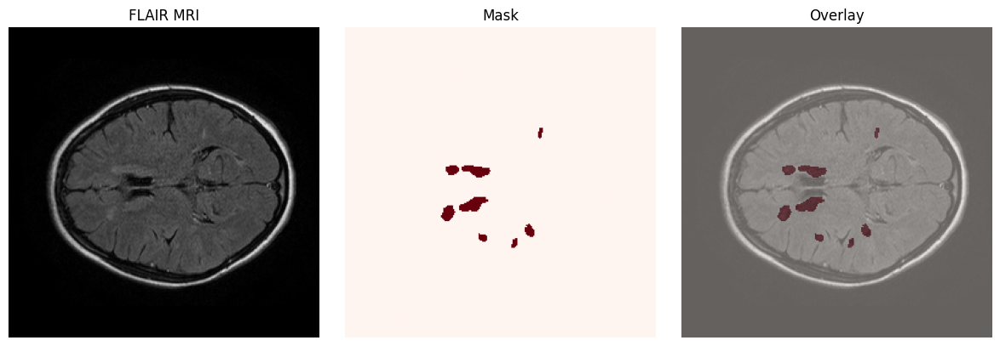

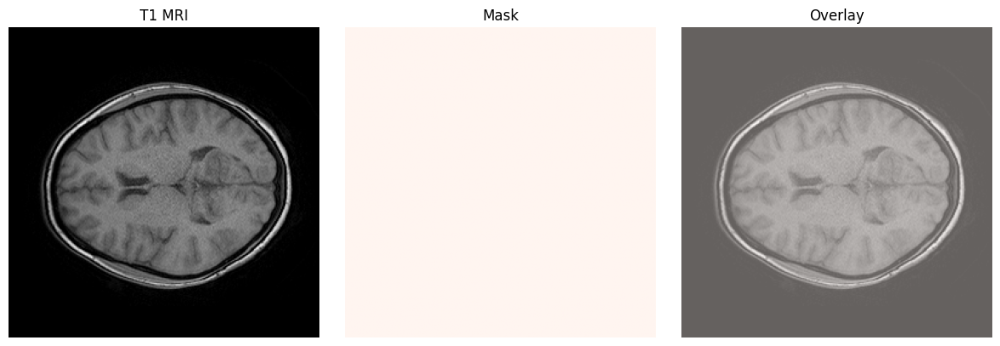

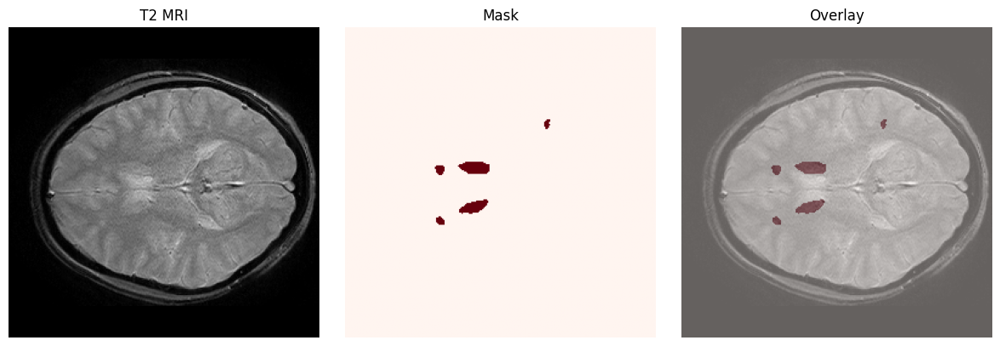

In [ ]:
def plot_patient(n=50, T1=True, T2=True, Flair=True):
    imgs = load_patient(n, as_dict=True, verbose=True)

    def show_images(base_img, mask_img, title):
        data = base_img.get_fdata()
        z = data.shape[2] // 2
        mri_slice = np.rot90(data[:, :, z])

        plt.figure(figsize=(12, 4))
        plt.subplot(1, 3 if mask_img else 1, 1)
        plt.imshow(mri_slice, cmap="gray")
        plt.title(f"{title} MRI"); plt.axis("off")

        if mask_img is not None:
            mask_data = mask_img.get_fdata()
            mask_slice = np.rot90(mask_data[:, :, min(z, mask_data.shape[2]-1)])
            plt.subplot(1, 3, 2)
            plt.imshow(mask_slice, cmap="Reds")
            plt.title("Mask"); plt.axis("off")

            plt.subplot(1, 3, 3)
            plt.imshow(mri_slice, cmap="gray")
            plt.imshow(mask_slice, cmap="Reds", alpha=0.4)
            plt.title("Overlay"); plt.axis("off")

        plt.tight_layout(); plt.show()

    if Flair and "flair" in imgs:
        show_images(imgs["flair"], imgs.get("lesionseg-flair"), "FLAIR")
    if T1 and "t1" in imgs:
        show_images(imgs["t1"], imgs.get("lesionseg-t1"), "T1")
    if T2 and "t2" in imgs:
        show_images(imgs["t2"], imgs.get("lesionseg-t2"), "T2")
    if not any([T1, T2, Flair]):
        print("⚠️ Nessuna modalità selezionata (usa T1=True, T2=True o Flair=True)")

plot_patient()

In [ ]:
import os
import numpy as np
import nibabel as nib
import tensorflow as tf
from tqdm import tqdm

os.chdir('/content/drive/MyDrive/Colab Notebooks')

dataset_dir = "/content/drive/MyDrive/Colab Notebooks/archive"
output_dir = "/content/drive/MyDrive/Colab Notebooks/archive_npz"


def convert_nii_to_npz(dataset_dir, output_dir, img_size=(128,128), modalities=["flair","t2"]):
    """
    Converts a dataset of NIfTI files to npz files with resized and normalized volumes.

    Args:
        dataset_dir (str): Path to the folder containing patient folders.
        output_dir (str): Path where the .npz files will be saved.
        img_size (tuple): Target (H,W) for resizing slices.
        modalities (list): List of modalities to process.
    """
    os.makedirs(output_dir, exist_ok=True)
    patient_folders = sorted([f for f in os.listdir(dataset_dir) if os.path.isdir(os.path.join(dataset_dir, f))])

    for pid in tqdm(patient_folders, desc="Processing patients"):
        patient_path = os.path.join(dataset_dir, pid)
        pid_num = pid.split('-')[1] if '-' in pid else pid  # handle Patient-1 or Patient1
        for seq in modalities:
            img_file = os.path.join(patient_path, f"{pid_num}-{seq.capitalize()}.nii")
            mask_file = os.path.join(patient_path, f"{pid_num}-LesionSeg-{seq.capitalize()}.nii")

            if not os.path.exists(img_file) or not os.path.exists(mask_file):
                print(f"⚠️ Missing {seq} files for {pid}, skipping")
                continue

            # Load volumes
            img_vol = nib.load(img_file).get_fdata()
            mask_vol = nib.load(mask_file).get_fdata()
            depth = img_vol.shape[2]

            # Preallocate resized arrays
            img_resized = np.zeros((img_size[0], img_size[1], depth), dtype=np.float32)
            mask_resized = np.zeros((img_size[0], img_size[1], depth), dtype=np.float32)

            for z in range(depth):
                # Resize slices
                img_resized[:,:,z] = tf.image.resize(img_vol[:,:,z][..., np.newaxis],
                                                     img_size,
                                                     method='bilinear').numpy()[...,0]
                mask_resized[:,:,z] = tf.image.resize(mask_vol[:,:,z][..., np.newaxis],
                                                      img_size,
                                                      method='nearest').numpy()[...,0]
            # Normalize image
            if img_resized.max() > 0:
                img_resized /= img_resized.max()

            # Save as compressed npz
            save_path = os.path.join(output_dir, f"{pid}_{seq}.npz")
            np.savez_compressed(save_path, image=img_resized, mask=mask_resized)


In [ ]:
# os.chdir('/content/drive/MyDrive/Colab Notebooks')
# os.listdir()

# dataset_dir = "archive"
# output_dir = "archive_npz"
# convert_nii_to_npz(dataset_dir, output_dir, img_size=(128,128))

import os
import nibabel as nib
import numpy as np
import cv2

def convert_nii_to_npz(dataset_dir, output_dir, img_size=(128,128)):
    os.makedirs(output_dir, exist_ok=True)

    patients = sorted([d for d in os.listdir(dataset_dir) if d.startswith("Patient-")])

    for pid in patients:
        pdir = os.path.join(dataset_dir, pid)
        pid_num = pid.split('-')[1]  # es. '1'

        # --- FLAIR ---
        flair_path = os.path.join(pdir, f"{pid_num}-Flair.nii")
        mask_flair_path = os.path.join(pdir, f"{pid_num}-LesionSeg-Flair.nii")

        if not os.path.exists(flair_path) or not os.path.exists(mask_flair_path):
            print(f"⚠️ Missing FLAIR or mask for {pid}, skipping")
        else:
            flair = nib.load(flair_path).get_fdata()
            mask_flair = nib.load(mask_flair_path).get_fdata()
            mask_flair = (mask_flair > 0).astype(np.uint8)

            H, W, Z = flair.shape
            flair_res = np.zeros((img_size[0], img_size[1], Z), dtype=np.float32)
            mask_res = np.zeros((img_size[0], img_size[1], Z), dtype=np.uint8)

            for z in range(Z):
                flair_res[:,:,z] = cv2.resize(flair[:,:,z], img_size, interpolation=cv2.INTER_LINEAR)
                mask_res[:,:,z] = cv2.resize(mask_flair[:,:,z], img_size, interpolation=cv2.INTER_NEAREST)

            if flair_res.max() > 0:
                flair_res /= flair_res.max()

            np.savez(os.path.join(output_dir, f"{pid}_flair.npz"),
                     image=flair_res,
                     mask=mask_res)
            print(f"✔ Saved {pid}_flair.npz")

        # --- T2 (opzionale) ---
        t2_path = os.path.join(pdir, f"{pid_num}-T2.nii")
        mask_t2_path = os.path.join(pdir, f"{pid_num}-LesionSeg-T2.nii")

        if os.path.exists(t2_path) and os.path.exists(mask_t2_path):
            t2 = nib.load(t2_path).get_fdata()
            mask_t2 = nib.load(mask_t2_path).get_fdata()
            mask_t2 = (mask_t2 > 0).astype(np.uint8)

            t2_res = np.zeros((img_size[0], img_size[1], Z), dtype=np.float32)
            mask_res_t2 = np.zeros((img_size[0], img_size[1], Z), dtype=np.uint8)

            for z in range(Z):
                t2_res[:,:,z] = cv2.resize(t2[:,:,z], img_size, interpolation=cv2.INTER_LINEAR)
                mask_res_t2[:,:,z] = cv2.resize(mask_t2[:,:,z], img_size, interpolation=cv2.INTER_NEAREST)

            if t2_res.max() > 0:
                t2_res /= t2_res.max()

            np.savez(os.path.join(output_dir, f"{pid}_t2.npz"),
                     image=t2_res,
                     mask=mask_res_t2)
            print(f"✔ Saved {pid}_t2.npz")



In [ ]:
import os
print(os.listdir("archive"))
print(os.listdir("archive_npz"))


FileNotFoundError: [Errno 2] No such file or directory: 'archive'

In [ ]:
import os
print(os.getcwd())
print(os.listdir())


/content/drive/MyDrive/Colab Notebooks/archive
['Supplementary Table 1 for patient info.xlsx', 'Supplementary Table 2 for  sequence parameters.xlsx', 'Patient-33', 'Patient-51', 'Patient-34', 'Patient-56', 'Patient-60', 'Patient-58', 'Patient-35', 'Patient-32', 'Patient-59', 'Patient-57', 'Patient-50', 'Patient-7', 'Patient-9', 'Patient-1', 'Patient-8', 'Patient-6', 'Patient-43', 'Patient-44', 'Patient-10', 'Patient-17', 'Patient-28', 'Patient-21', 'Patient-26', 'Patient-19', 'Patient-18', 'Patient-42', 'Patient-27', 'Patient-45', 'Patient-20', 'Patient-16', 'Patient-11', 'Patient-29', 'Patient-55', 'Patient-52', 'Patient-37', 'Patient-30', 'Patient-39', 'Patient-53', 'Patient-38', 'Patient-54', 'Patient-31', 'Patient-36', 'Patient-3', 'Patient-4', 'Patient-5', 'Patient-2', 'Patient-14', 'Patient-13', 'Patient-25', 'Patient-22', 'Patient-49', 'Patient-47', 'Patient-40', 'Patient-23', 'Patient-24', 'Patient-12', 'Patient-15', 'Patient-41', 'Patient-46', 'Patient-48']


In [ ]:
import os

for root, dirs, files in os.walk("/content/drive", topdown=True):
    if "archive" in dirs:
        print("Trovata cartella archive in:", os.path.join(root, "archive"))


Trovata cartella archive in: /content/drive/MyDrive/Colab Notebooks/archive
Trovata cartella archive in: /content/drive/.Encrypted/MyDrive/Colab Notebooks/archive


In [ ]:
import os
print(os.listdir("/content/drive/MyDrive/Colab Notebooks/archive/Patient-1"))


['1-T1.nii', '1-LesionSeg-T1.nii', '1-LesionSeg-Flair.nii', '1-LesionSeg-T2.nii', '1-Flair.nii', '1-T2.nii']


In [ ]:
from tensorflow.keras.utils import Sequence
import numpy as np
import os
import tensorflow as tf

IMG_SIZE = (128, 128)  # H, W

class DataGenerator(Sequence):
    """
    Slice-wise generator for preprocessed .npz volumes.
    Supports arbitrary MRI modalities (e.g. ["flair"], ["flair","t2"]).
    """

    def __init__(self, patient_ids, data_dir="archive_npz", batch_size=8,
                 shuffle=True, use_all_slices=False, augment=True,
                 verbose=True, modalities=["flair"], **kwargs):

        super().__init__(**kwargs)
        self.patient_ids = patient_ids
        self.data_dir = data_dir
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.use_all_slices = use_all_slices
        self.augment = augment
        self.verbose = verbose
        self.modalities = modalities

        self.slice_info = self._prepare_slice_index()
        self.cache = {}
        self.on_epoch_end()


    def _prepare_slice_index(self):
        slice_info = []
        for pid in self.patient_ids:
            for seq in self.modalities:
                npz_file = os.path.join(self.data_dir, f"{pid}_{seq}.npz")
                if not os.path.exists(npz_file):
                    if self.verbose:
                        print(f"⚠️ Missing {seq} for {pid}, skipping")
                    continue

                data = np.load(npz_file)
                depth = data["image"].shape[2]
                start = 0 if self.use_all_slices else int(depth*0.25)
                end   = depth if self.use_all_slices else int(depth*0.75)

                for z in range(start, end):
                    mask_slice = data["mask"][:, :, z]
                    if mask_slice.sum() > 0:
                        slice_info.append((pid, seq, z))

        if len(slice_info) == 0:
            print("⚠️ No slices found in dataset")
        return slice_info


    def __len__(self):
        return int(np.ceil(len(self.slice_info) / self.batch_size))


    def on_epoch_end(self):
        if self.shuffle:
            np.random.shuffle(self.slice_info)
        self.cache = {}  # pulizia cache


    def __getitem__(self, index):
        X_batch, y_batch = [], []
        batch_slices = self.slice_info[index*self.batch_size:(index+1)*self.batch_size]

        for pid, seq, z in batch_slices:
            if pid not in self.cache:
                self.cache[pid] = {}
            if seq not in self.cache[pid]:
                npz_file = os.path.join(self.data_dir, f"{pid}_{seq}.npz")
                d = np.load(npz_file)
                self.cache[pid][seq] = {"image": d["image"], "mask": d["mask"]}

            vol_img = self.cache[pid][seq]["image"]
            vol_mask = self.cache[pid][seq]["mask"]

            img = vol_img[:, :, z][..., np.newaxis].astype(np.float32)
            mask = vol_mask[:, :, z][..., np.newaxis].astype(np.float32)

            if img.max() > 0:
                img /= img.max()

            if self.augment:
                img, mask = self._augment(img, mask)

            X_batch.append(img)
            y_batch.append(mask)

        if len(X_batch) == 0:
            X_batch = [np.zeros((IMG_SIZE[0], IMG_SIZE[1], 1), dtype=np.float32)]*self.batch_size
            y_batch = [np.zeros((IMG_SIZE[0], IMG_SIZE[1], 1), dtype=np.float32)]*self.batch_size

        return np.array(X_batch, dtype=np.float32), np.array(y_batch, dtype=np.float32)


    # ------------ AUGMENTATION ------------
    def _augment(self, x, y):
        # flip orizzontale e verticale
        if np.random.rand() > 0.5: x, y = np.flip(x,1), np.flip(y,1)
        if np.random.rand() > 0.5: x, y = np.flip(x,0), np.flip(y,0)
        # rotazione 0/90/180/270
        k = np.random.randint(0,4)
        x, y = np.rot90(x,k,axes=(0,1)), np.rot90(y,k,axes=(0,1))
        # resize all'IMG_SIZE
        x = tf.image.resize(tf.convert_to_tensor(x), IMG_SIZE).numpy()
        y = tf.image.resize(tf.convert_to_tensor(y), IMG_SIZE, method="nearest").numpy()
        # intensità, contrasto e rumore
        x = random_gamma(x)
        x = random_contrast(x)
        x = add_noise(x)
        return x.astype(np.float32), y.astype(np.float32)


# ------------ FUNZIONI DI SUPPORTO ------------
def add_noise(x, std=0.01):
    x = x + np.random.normal(0,std,x.shape)
    return np.clip(x,0,1)

def random_gamma(x, gamma_range=(0.8,1.2)):
    gamma = np.random.uniform(*gamma_range)
    return np.clip(x ** gamma,0,1)

def random_contrast(x, lower=0.8, upper=1.2):
    factor = np.random.uniform(lower, upper)
    mean = x.mean()
    x = (x - mean) * factor + mean
    return np.clip(x, 0, 1)


X batch shape: (1, 128, 128, 1)
y batch shape: (1, 128, 128, 1)


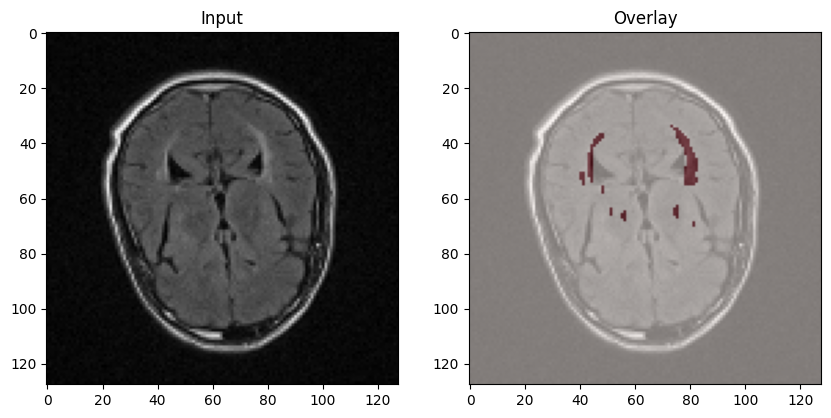

In [ ]:
patient_ids = [f"Patient-{i}" for i in range(1,61)]  # esempio con Patient-47
# Use the NPZ-based generator
gen = DataGenerator(patient_ids, batch_size = 1, verbose=True)

# Get first batch
X, y = gen[0]
print("X batch shape:", X.shape)  # (B,H,W,1)
print("y batch shape:", y.shape)  # (B,H,W,1)

import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))

# Input
plt.subplot(1,2,1)
plt.imshow(X[0,...,0], cmap='gray')
plt.title("Input")

# Overlay
plt.subplot(1,2,2)
plt.imshow(X[0,...,0], cmap='gray')
plt.imshow(y[0,...,0], cmap='Reds', alpha=0.5)  # semi-transparent red mask
plt.title("Overlay")

plt.show()




In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models

def build_unet(input_shape=(128,128,1), num_classes=1, base_filters=32, dropout_rate=0.2):
    """
    2D U-Net with batch normalization, dropout, and multi-channel input.
    """
    inputs = layers.Input(shape=input_shape)

    # --- Encoder ---
    c1 = layers.Conv2D(base_filters, 3, padding='same')(inputs)
    c1 = layers.BatchNormalization()(c1)
    c1 = layers.Activation('relu')(c1)
    c1 = layers.Conv2D(base_filters, 3, padding='same')(c1)
    c1 = layers.BatchNormalization()(c1)
    c1 = layers.Activation('relu')(c1)
    p1 = layers.MaxPooling2D((2,2))(c1)
    p1 = layers.Dropout(dropout_rate)(p1)

    c2 = layers.Conv2D(base_filters*2, 3, padding='same')(p1)
    c2 = layers.BatchNormalization()(c2)
    c2 = layers.Activation('relu')(c2)
    c2 = layers.Conv2D(base_filters*2, 3, padding='same')(c2)
    c2 = layers.BatchNormalization()(c2)
    c2 = layers.Activation('relu')(c2)
    p2 = layers.MaxPooling2D((2,2))(c2)
    p2 = layers.Dropout(dropout_rate)(p2)

    c3 = layers.Conv2D(base_filters*4, 3, padding='same')(p2)
    c3 = layers.BatchNormalization()(c3)
    c3 = layers.Activation('relu')(c3)
    c3 = layers.Conv2D(base_filters*4, 3, padding='same')(c3)
    c3 = layers.BatchNormalization()(c3)
    c3 = layers.Activation('relu')(c3)
    p3 = layers.MaxPooling2D((2,2))(c3)
    p3 = layers.Dropout(dropout_rate)(p3)

    c4 = layers.Conv2D(base_filters*8, 3, padding='same')(p3)
    c4 = layers.BatchNormalization()(c4)
    c4 = layers.Activation('relu')(c4)
    c4 = layers.Conv2D(base_filters*8, 3, padding='same')(c4)
    c4 = layers.BatchNormalization()(c4)
    c4 = layers.Activation('relu')(c4)
    p4 = layers.MaxPooling2D((2,2))(c4)
    p4 = layers.Dropout(dropout_rate)(p4)

    # --- Bottleneck ---
    c5 = layers.Conv2D(base_filters*16, 3, padding='same')(p4)
    c5 = layers.BatchNormalization()(c5)
    c5 = layers.Activation('relu')(c5)
    c5 = layers.Conv2D(base_filters*16, 3, padding='same')(c5)
    c5 = layers.BatchNormalization()(c5)
    c5 = layers.Activation('relu')(c5)
    c5 = layers.Dropout(dropout_rate)(c5)

    # --- Decoder ---
    u6 = layers.Conv2DTranspose(base_filters*8, 2, strides=(2,2), padding='same')(c5)
    u6 = layers.concatenate([u6, c4])
    c6 = layers.Conv2D(base_filters*8, 3, padding='same')(u6)
    c6 = layers.BatchNormalization()(c6)
    c6 = layers.Activation('relu')(c6)
    c6 = layers.Conv2D(base_filters*8, 3, padding='same')(c6)
    c6 = layers.BatchNormalization()(c6)
    c6 = layers.Activation('relu')(c6)

    u7 = layers.Conv2DTranspose(base_filters*4, 2, strides=(2,2), padding='same')(c6)
    u7 = layers.concatenate([u7, c3])
    c7 = layers.Conv2D(base_filters*4, 3, padding='same')(u7)
    c7 = layers.BatchNormalization()(c7)
    c7 = layers.Activation('relu')(c7)
    c7 = layers.Conv2D(base_filters*4, 3, padding='same')(c7)
    c7 = layers.BatchNormalization()(c7)
    c7 = layers.Activation('relu')(c7)

    u8 = layers.Conv2DTranspose(base_filters*2, 2, strides=(2,2), padding='same')(c7)
    u8 = layers.concatenate([u8, c2])
    c8 = layers.Conv2D(base_filters*2, 3, padding='same')(u8)
    c8 = layers.BatchNormalization()(c8)
    c8 = layers.Activation('relu')(c8)
    c8 = layers.Conv2D(base_filters*2, 3, padding='same')(c8)
    c8 = layers.BatchNormalization()(c8)
    c8 = layers.Activation('relu')(c8)

    u9 = layers.Conv2DTranspose(base_filters, 2, strides=(2,2), padding='same')(c8)
    u9 = layers.concatenate([u9, c1])
    c9 = layers.Conv2D(base_filters, 3, padding='same')(u9)
    c9 = layers.BatchNormalization()(c9)
    c9 = layers.Activation('relu')(c9)
    c9 = layers.Conv2D(base_filters, 3, padding='same')(c9)
    c9 = layers.BatchNormalization()(c9)
    c9 = layers.Activation('relu')(c9)

    # --- Output ---
    outputs = layers.Conv2D(num_classes, 1, activation='sigmoid')(c9)

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model


In [ ]:
import tensorflow as tf
from tensorflow.keras import backend as K

# ---------------- METRICHE ----------------
def dice_coef(y_true, y_pred, smooth=1e-6):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def iou_coef(y_true, y_pred, smooth=1e-6):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f) - intersection
    return (intersection + smooth) / (union + smooth)

# ---------------- LOSS ----------------
def dice_loss(y_true, y_pred):
    return 1.0 - dice_coef(y_true, y_pred)

def bce_dice_loss(y_true, y_pred, bce_weight=0.5):
    """
    Combina BCE e Dice Loss.
    bce_weight: peso della BCE (0.5 = metà BCE, metà Dice)
    """
    bce = tf.keras.losses.binary_crossentropy(y_true, y_pred)
    d_loss = dice_loss(y_true, y_pred)
    return bce_weight * bce + (1 - bce_weight) * d_loss

# ---------------- PESO SLICES ----------------
def compute_slice_weights(generator):
    """
    Calcola un array di pesi per ogni slice nel dataset.
    Più la slice ha lesione, più peso ha (opzionale).
    """
    weights = []
    for pid, seq, z in generator.slice_info:
        mask = np.load(os.path.join(generator.data_dir, f"{pid}_{seq}.npz"))["mask"][:, :, z]
        lesion_ratio = mask.sum() / (mask.shape[0] * mask.shape[1])
        # peso minimo 0.1 per slice senza lesione, max 1.0
        weight = max(0.1, min(1.0, lesion_ratio*5))
        weights.append(weight)
    return np.array(weights)


In [ ]:
import random

# --- Patient split ---
all_patient_ids = [f"Patient-{i}" for i in range(1, 61)]
random.shuffle(all_patient_ids)

n_total = len(all_patient_ids)
n_train = int(0.80 * n_total)  # 80%
n_val   = int(0.10 * n_total)  # 10%
n_test  = n_total - n_train - n_val  # 10%

train_ids = all_patient_ids[:n_train]
val_ids   = all_patient_ids[n_train:n_train+n_val]
test_ids  = all_patient_ids[n_train+n_val:]

print(f"Train: {len(train_ids)} patients")
print(f"Validation: {len(val_ids)} patients")
print(f"Test: {len(test_ids)} patients")

# --- Modalità da usare ---
modalities = ["flair", "t2"]

# --- Create generators using preprocessed .npz files ---
train_gen = DataGenerator(
    patient_ids=train_ids,
    batch_size=32,
    augment=True,
    use_all_slices=False,
    modalities=modalities
)

val_gen = DataGenerator(
    patient_ids=val_ids,
    batch_size=32,
    augment=False,
    use_all_slices=False,
    modalities=modalities
)

test_gen = DataGenerator(
    patient_ids=test_ids,
    batch_size=32,
    augment=False,
    use_all_slices=False,
    modalities=modalities
)


Train: 48 patients
Validation: 6 patients
Test: 6 patients


In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# --- Save best weights ---
checkpoint_cb = ModelCheckpoint(
    "best_model.keras",            # path to save the model
    monitor="val_loss",         # metric to monitor
    save_best_only=True,        # only save the best model
    mode="min",                 # minimize the monitored metric
    verbose=0
)

# --- Stop early if no improvement ---
earlystop_cb = EarlyStopping(
    monitor="val_loss",         # metric to monitor
    patience=20,                # stop after 20 epochs with no improvement
    verbose=0,
    restore_best_weights=True   # restore best weights at the end
)

# --- Reduce learning rate if no improvement ---
reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',   # metric to monitor
    factor=0.5,           # LR is multiplied by this factor
    patience=5,           # number of epochs with no improvement before reducing LR
    min_lr=1e-6,          # lower bound on LR
    verbose=1
)



In [ ]:
# --- Build and Compile U-Net ---
model = build_unet()

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
    loss=dice_loss,
    metrics=[dice_coef, iou_coef, sensitivity, specificity]
)

# --- Allenamento ---
history = model.fit(train_gen,
          validation_data = val_gen,
          epochs=200,
          callbacks=[checkpoint_cb]
          )


Epoch 1/200
27/27 ━━━━━━━━━━━━━━━━━━━━ 43s 742ms/step - dice_coef: 0.0154 - iou_coef: 0.0078 - loss: 0.9852 - sensitivity: 0.8899 - specificity: 0.4001 - val_dice_coef: 0.0094 - val_iou_coef: 0.0047 - val_loss: 0.9908 - val_sensitivity: 0.9998 - val_specificity: 0.5569
Epoch 2/200
27/27 ━━━━━━━━━━━━━━━━━━━━ 5s 169ms/step - dice_coef: 0.0243 - iou_coef: 0.0123 - loss: 0.9756 - sensitivity: 0.9947 - specificity: 0.6590 - val_dice_coef: 0.0111 - val_iou_coef: 0.0056 - val_loss: 0.9891 - val_sensitivity: 0.9951 - val_specificity: 0.6406
Epoch 3/200
27/27 ━━━━━━━━━━━━━━━━━━━━ 5s 172ms/step - dice_coef: 0.0292 - iou_coef: 0.0148 - loss: 0.9709 - sensitivity: 0.9829 - specificity: 0.7680 - val_dice_coef: 0.0124 - val_iou_coef: 0.0063 - val_loss: 0.9871 - val_sensitivity: 0.9997 - val_specificity: 0.5753
Epoch 4/200
27/27 ━━━━━━━━━━━━━━━━━━━━ 5s 168ms/step - dice_coef: 0.0369 - iou_coef: 0.0188 - loss: 0.9632 - sensitivity: 0.9556 - specificity: 0.8240 - val_dice_coef: 0.0114 - val_iou_coef: 0

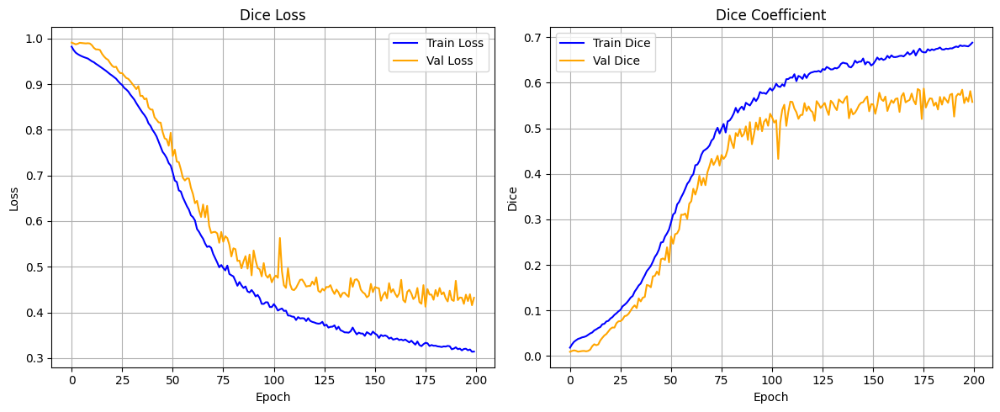

In [ ]:
import matplotlib.pyplot as plt

# Assuming `history` is the object returned by model.fit()
# history = model.fit(...)

# --- Plot Loss ---
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(history.history['loss'], label='Train Loss', color='blue')
plt.plot(history.history['val_loss'], label='Val Loss', color='orange')
plt.title("Dice Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.grid(True)

# --- Plot Dice Coefficient ---
plt.subplot(1,2,2)
plt.plot(history.history['dice_coef'], label='Train Dice', color='blue')
plt.plot(history.history['val_dice_coef'], label='Val Dice', color='orange')
plt.title("Dice Coefficient")
plt.xlabel("Epoch")
plt.ylabel("Dice")
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()


In [ ]:
# --- Valutazione su test set ---
print("Evaluating on train set...")
train_metrics = model.evaluate(train_gen)
#print("Train metrics:", train_metrics)
print("Evaluating on validation set...")
val_metrics = model.evaluate(val_gen)
print("Evaluatin on test set...")
#print("\n\nVal metrics:", val_metrics)
test_metrics = model.evaluate(test_gen)
#print("\n\nTest metrics:", test_metrics)

Evaluating on train set...
27/27 ━━━━━━━━━━━━━━━━━━━━ 6s 191ms/step - dice_coef: 0.6913 - iou_coef: 0.5289 - loss: 0.3087 - sensitivity: 0.7454 - specificity: 0.9977
Evaluating on validation set...
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - dice_coef: 0.5640 - iou_coef: 0.3936 - loss: 0.4367 - sensitivity: 0.6314 - specificity: 0.9975
Evaluatin on test set...
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 400ms/step - dice_coef: 0.5378 - iou_coef: 0.3681 - loss: 0.4614 - sensitivity: 0.6578 - specificity: 0.9967


In [ ]:
model.save("my_unet_model_12_59.keras")

In [ ]:
# model = tf.keras.models.load_model("best_model.h5",
#                                    custom_objects={"dice_loss": dice_loss,
#                                                    "dice_coef": dice_coef}
# )

In [ ]:
model.summary()

Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_11      │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_209 (Conv2D) │ (None, 128, 128,  │        320 │ input_layer_11[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        128 │ conv2d_209[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_198      │ (None, 128, 128,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_210 (Conv2D) │ (None, 128, 128,  │      9,248 │ activation_198[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        128 │ conv2d_210[0][0]  │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_199      │ (None, 128, 128,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_44    │ (None, 64, 64,    │          0 │ activation_199[0… │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_55          │ (None, 64, 64,    │          0 │ max_pooling2d_44… │
│ (Dropout)           │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_211 (Conv2D) │ (None, 64, 64,    │     18,496 │ dropout_55[0][0]  │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        256 │ conv2d_211[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_200      │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_212 (Conv2D) │ (None, 64, 64,    │     36,928 │ activation_200[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        256 │ conv2d_212[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_201      │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_45    │ (None, 32, 32,    │          0 │ activation_201[0… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_56          │ (None, 32, 32,    │          0 │ max_pooling2d_45

 Total params: 7,771,299 (29.65 MB)

 Trainable params: 7,765,409 (29.62 MB)

 Non-trainable params: 5,888 (23.00 KB)

 Optimizer params: 2 (12.00 B)

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


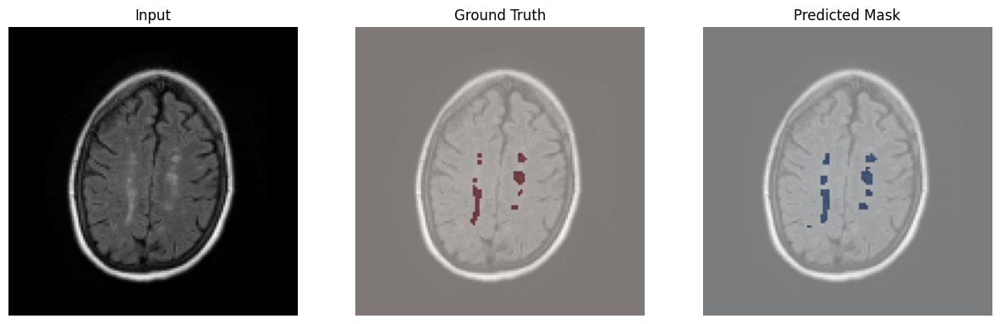

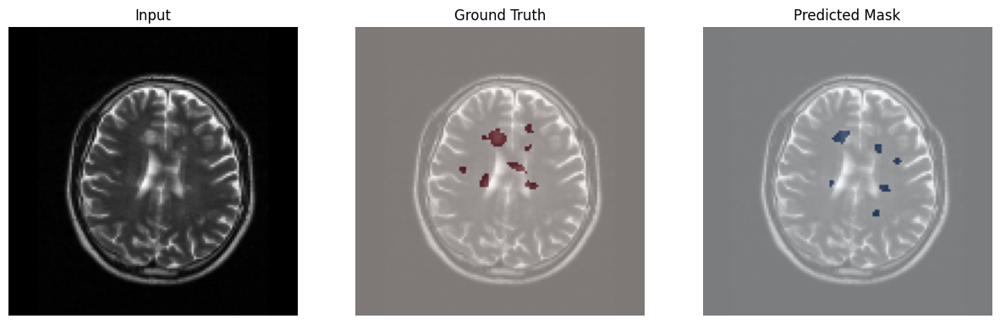

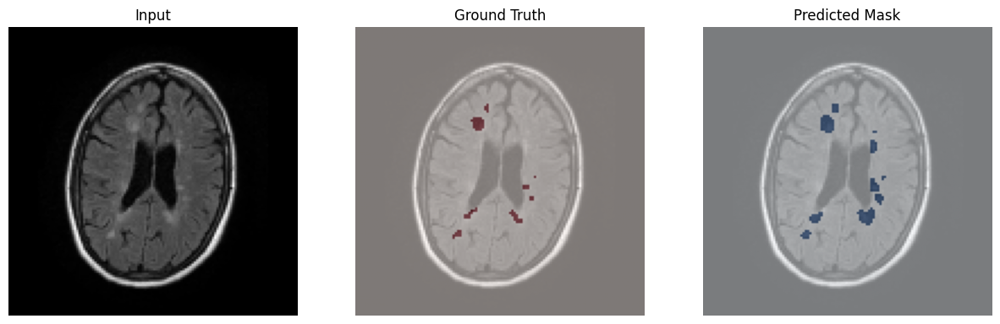

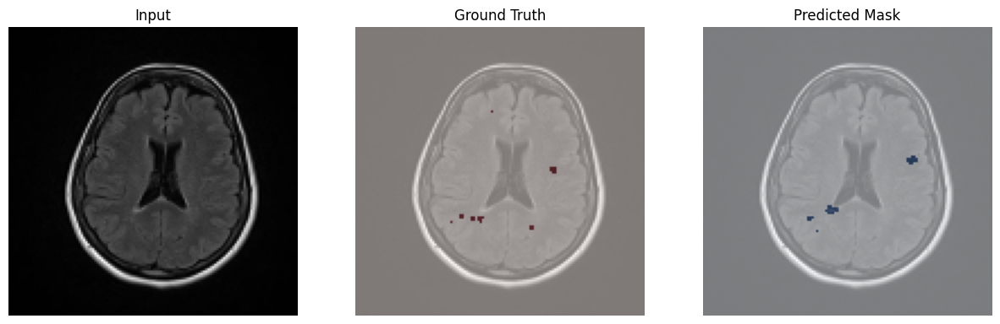

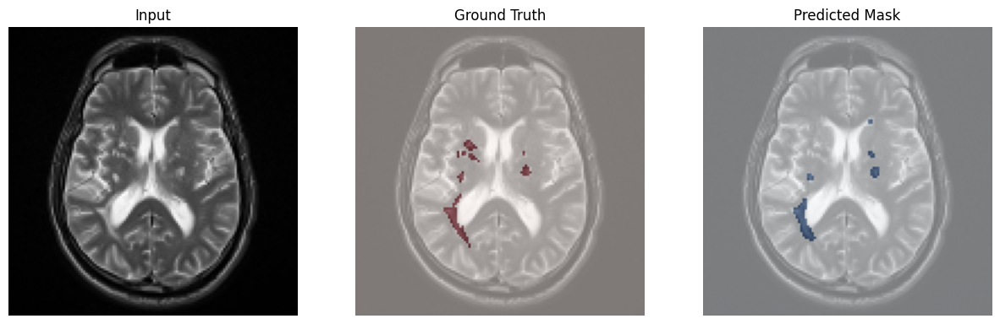

...

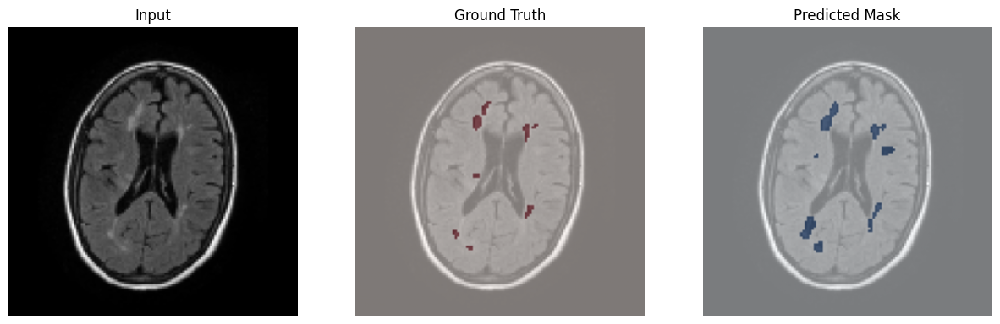

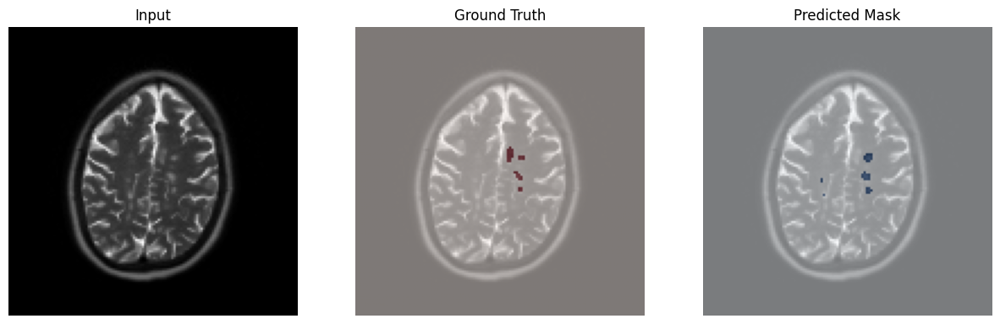

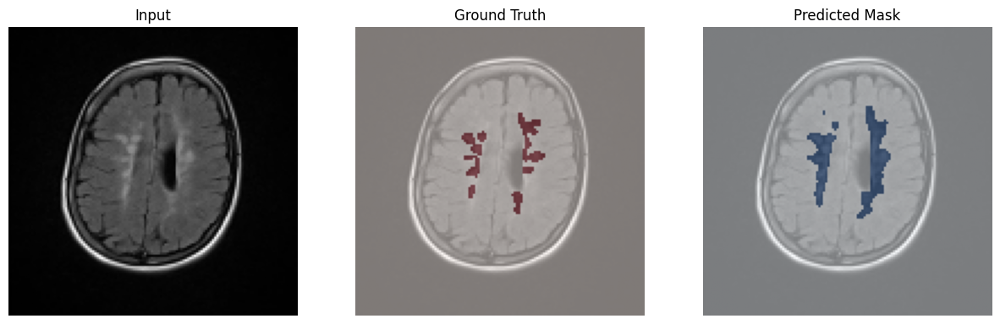

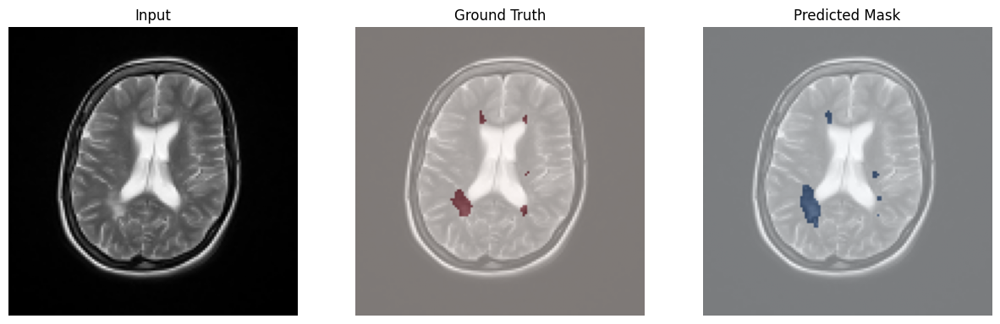

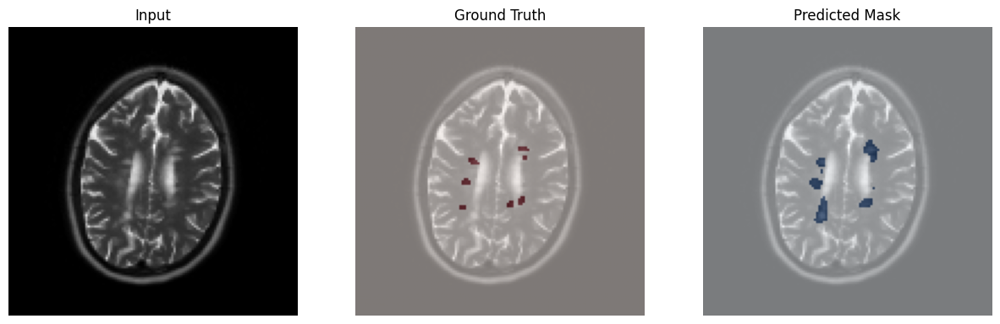

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


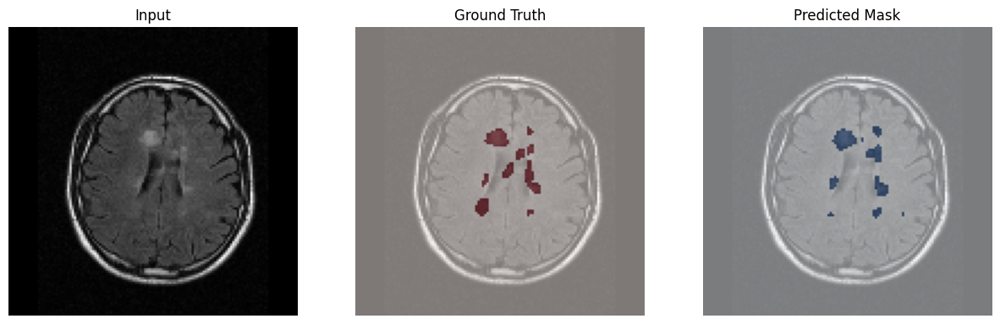

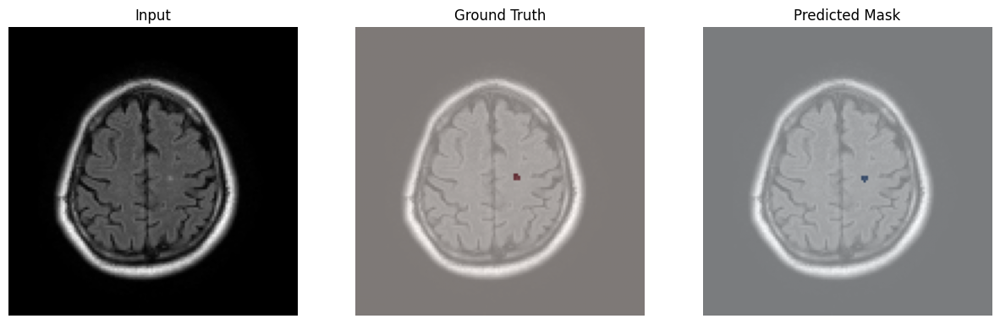

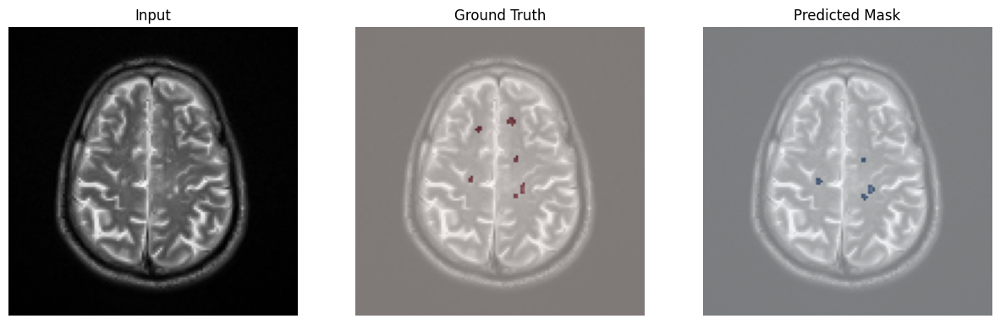

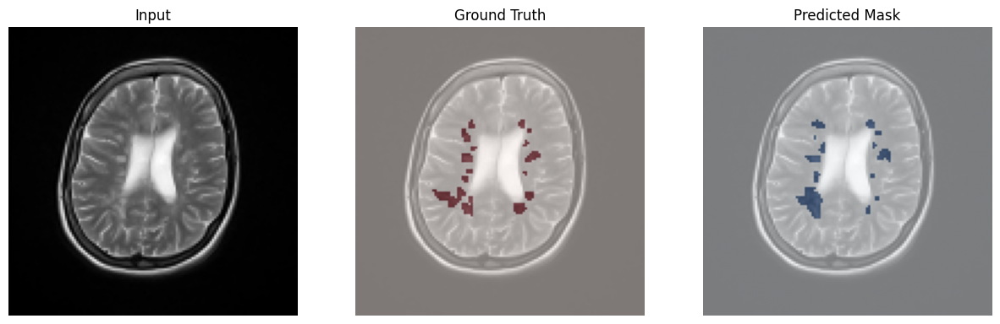

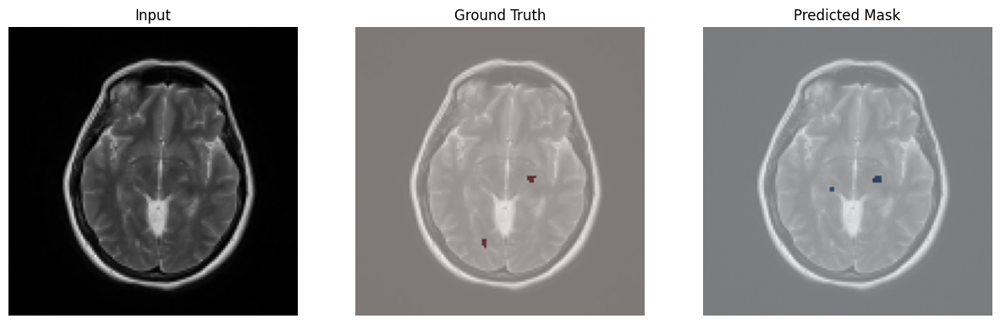

...

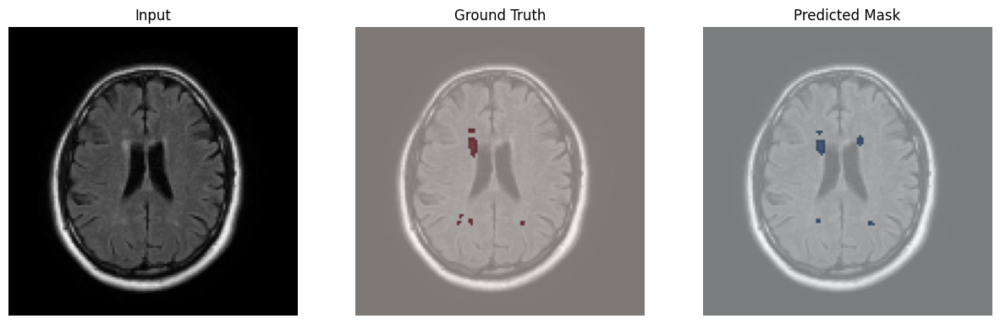

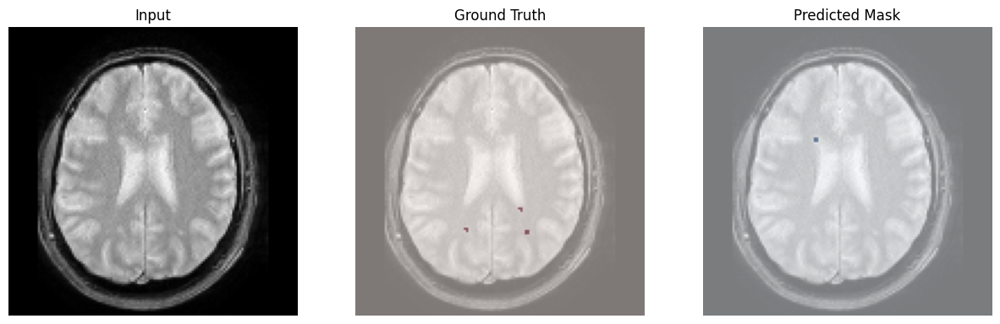

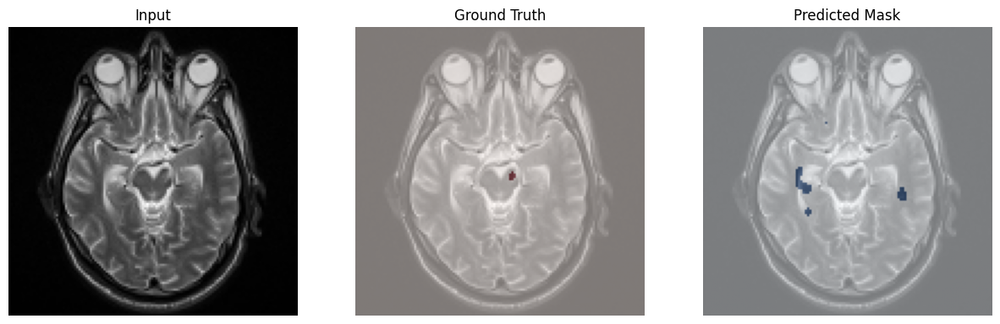

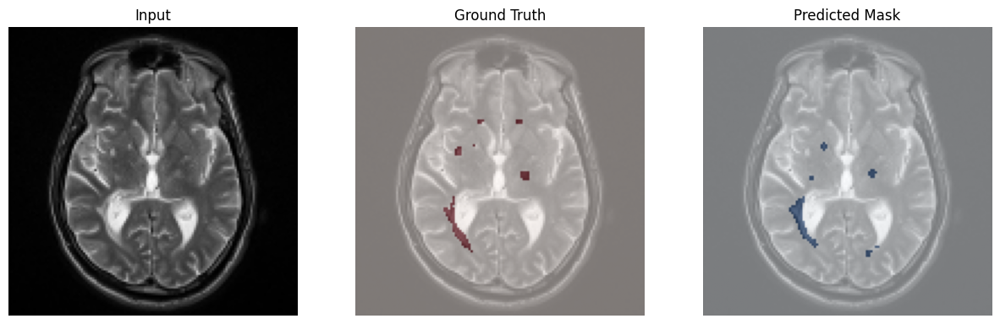

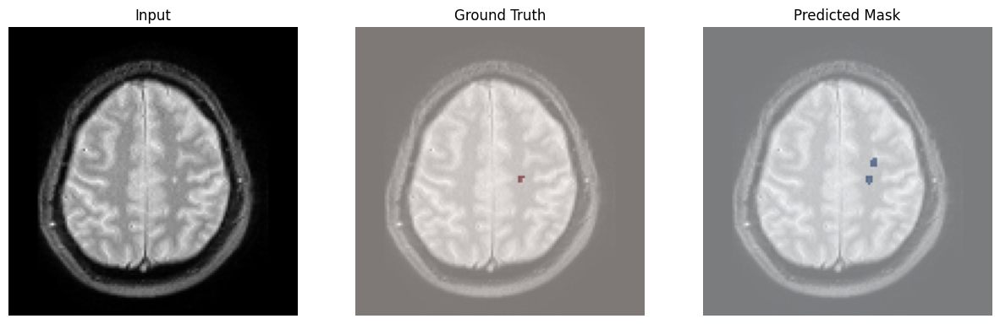

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


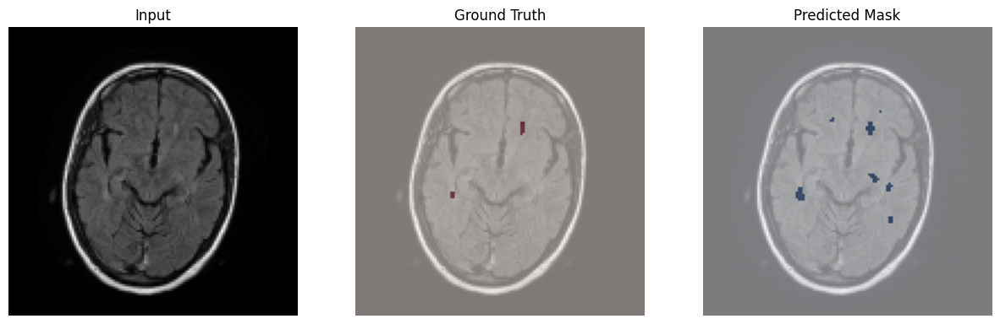

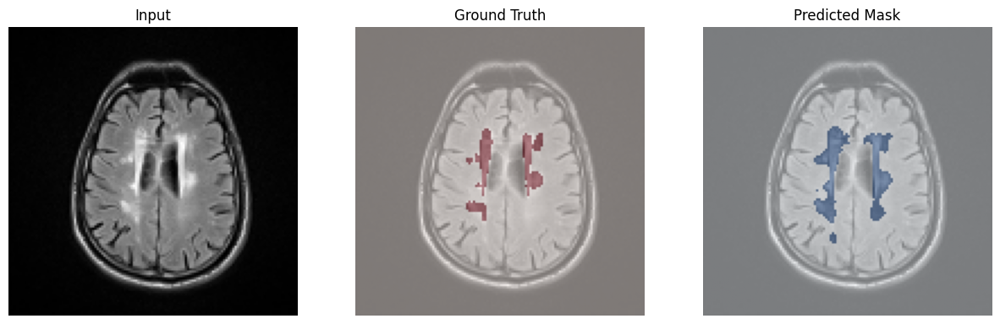

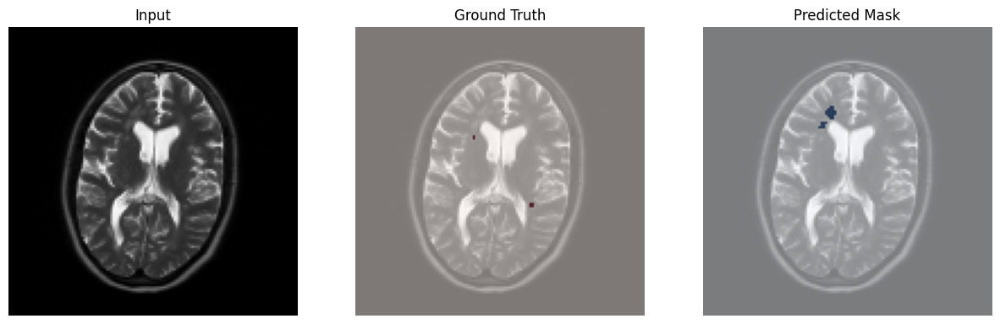

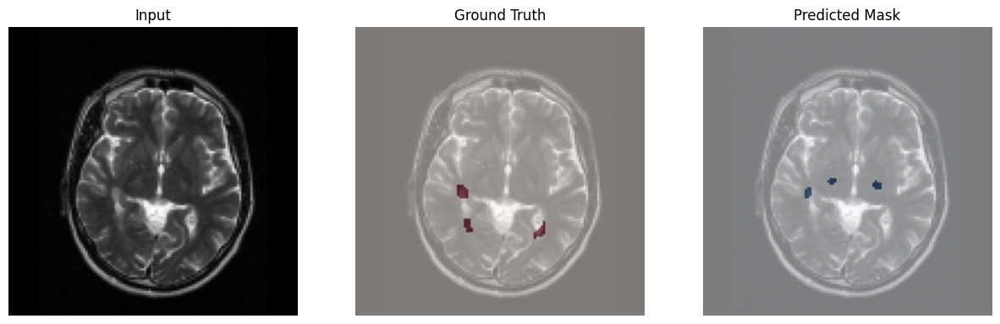

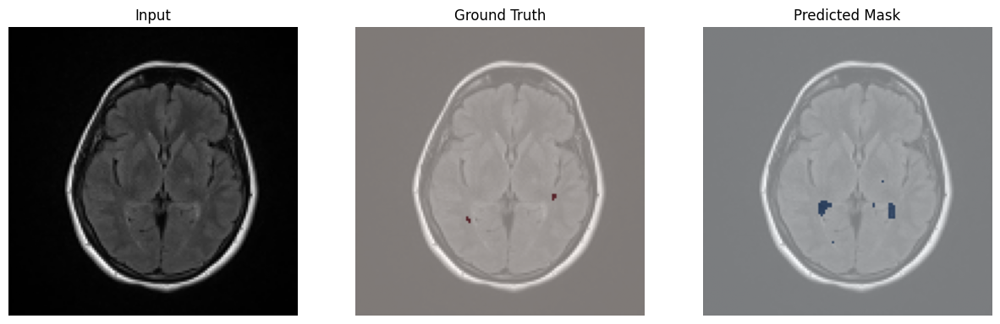

...

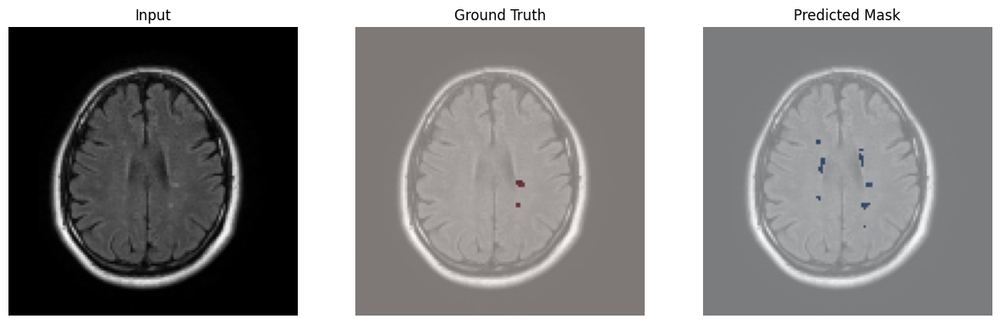

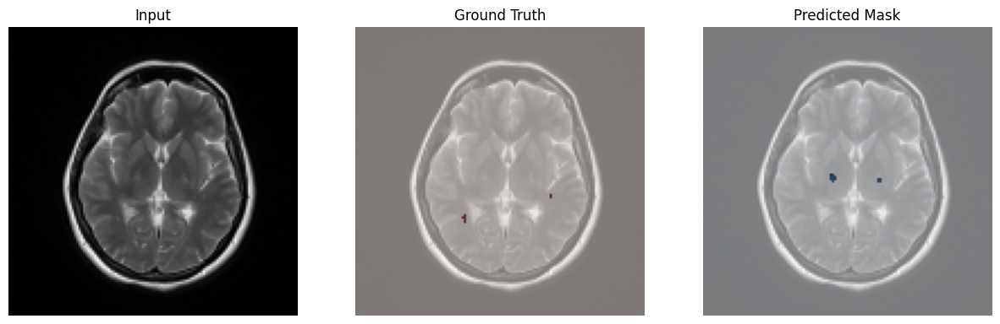

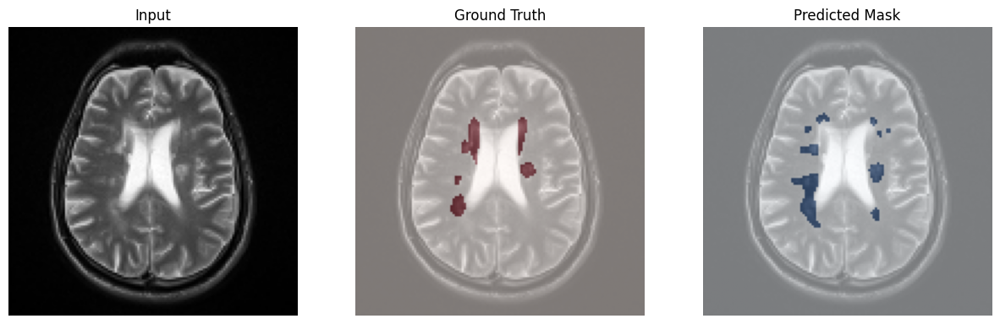

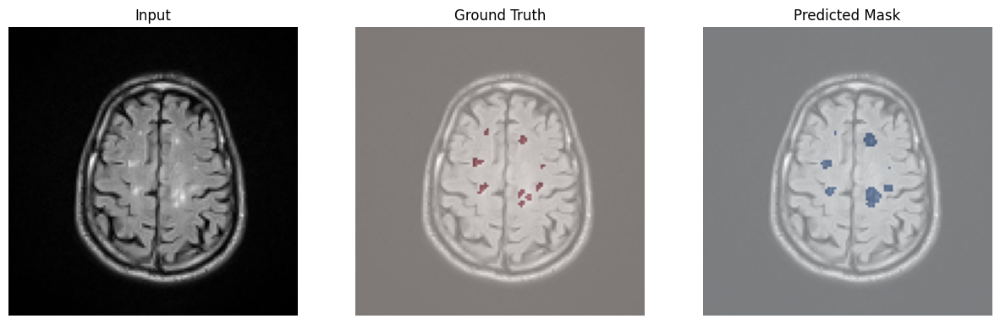

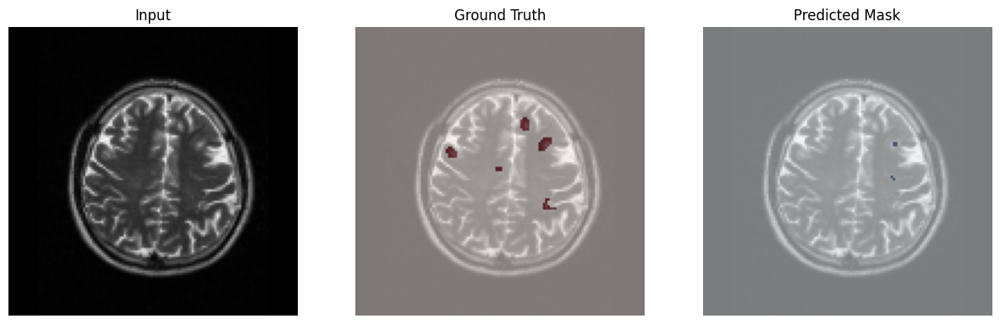

In [ ]:
import matplotlib.pyplot as plt

for i in range(3):
  X, y = test_gen[i]
  y_pred = model.predict(X)  #
  y_pred_bin = tf.round(y_pred)  # threshold 0.5

  for j in range(32):
    plt.figure(figsize=(15,5))

    # Input
    plt.subplot(1,3,1)
    plt.imshow(X[j,...,0], cmap='gray')
    plt.title("Input")
    plt.axis('off')

    # Ground Truth Overlay
    plt.subplot(1,3,2)
    plt.imshow(X[j,...,0], cmap='gray')
    plt.imshow(y[j,...,0], cmap='Reds', alpha=0.5)  # semi-transparent
    plt.title("Ground Truth")
    plt.axis('off')

    # Predicted Overlay
    plt.subplot(1,3,3)
    plt.imshow(X[j,...,0], cmap='gray')
    plt.imshow(y_pred_bin[j,...,0], cmap='Blues', alpha=0.5)  # blue overlay
    plt.title("Predicted Mask")
    plt.axis('off')

    plt.show()


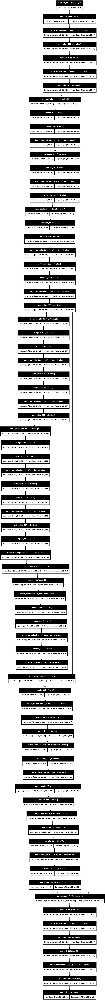

In [ ]:
from tensorflow.keras.utils import plot_model

plot_model(model,
           to_file='unet_architecture.png',  # nome del file di output
           show_shapes=True,   # mostra le dimensioni dei tensori
           show_layer_names=True,  # mostra i nomi dei layer
           dpi=100)


In [ ]:
!pip install visualkeras

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 62.3 MB/s eta 0:00:00


In [ ]:
import visualkeras

In [ ]:
import visualkeras
from tensorflow.keras.layers import Layer

# --- Fix universale per Keras >= 2.15 ---
for layer in model.layers:
    if not hasattr(layer, "output_shape"):
        try:
            layer.output_shape = layer.compute_output_shape(layer.input_shape)
        except Exception:
            layer.output_shape = (None, None, None, None)

# --- Crea e salva la visualizzazione ---
img = visualkeras.layered_view(
    model,
    legend=True,
    scale_xy=2,
    scale_z=1,
    to_file="unet_visualkeras_fixed.png"  # salva l'immagine
)
img.show()  # mostra direttamente in output
